In [1]:
#!/usr/bin/env python2
import os
import sys
import argparse
import time
from distutils.dir_util import copy_tree


import numpy as np
import random
import theano
import theano.tensor as T
from theano import config
import lasagne
from lasagne.regularization import regularize_network_params
from lasagne.objectives import binary_crossentropy

from iterator import Iterator
import autoencoder_model as ae_model

import PIL.Image as Image
from matplotlib import pyplot as plt
from matplotlib import colors
%matplotlib inline


_FLOATX = config.floatX


Using gpu device 0: Quadro K6000 (CNMeM is enabled with initial size: 95.0% of memory, cuDNN 5105)
/u/larocste/.local/lib/python2.7/site-packages/theano/sandbox/cuda/__init__.py:600: UserWarning: Your cuDNN version is more recent than the one Theano officially supports. If you see any problems, try updating Theano or downgrading cuDNN to version 5.
  warnings.warn(warn)


In [2]:
#Training hyper-parameters

learning_rate = 0.01
weight_decay = 0
num_epochs = 500
max_patience = 100
#data_augmentation={}
SAVEPATH = 'save_models' 
LOADPATH = 'load_models'
batch_size = 512
extract_center = True
load_caption = True
#nb_discriminator_steps = 2

#Model Hyperparameters
conv_before_pool=[2,2]
n_filters = 32                      
code_size = 750
filter_size = 3
pool_factor = 2



In [3]:
#######################
# Saving path and stuff
######################
exp_name = 'AE_notebook'
exp_name += '_lr='+str(learning_rate)
exp_name += '_wd='+str(weight_decay)
exp_name += '_bs='+str(batch_size)
exp_name += '_conv='+str(conv_before_pool)
exp_name += '_nfilt='+str(n_filters)
exp_name += '_code='+str(code_size)
exp_name += '_caps'



savepath=os.path.join(sys.path[1],SAVEPATH, exp_name)
loadpath=os.path.join(sys.path[1],LOADPATH, exp_name)

if not os.path.exists(savepath):
    os.makedirs(savepath)
else:
    print('\033[93m The following folder already exists {}. '
          'It will be overwritten in a few seconds...\033[0m'.format(
              savepath))
print 'Saving directory : ' + savepath
print 'Loading directory : '+ loadpath

 The following folder already exists /u/larocste/ift6266_project/save_models/AE_notebook_lr=0.01_wd=0_bs=512_conv=[2, 2]_nfilt=32_code=750_caps. It will be overwritten in a few seconds...
Saving directory : /u/larocste/ift6266_project/save_models/AE_notebook_lr=0.01_wd=0_bs=512_conv=[2, 2]_nfilt=32_code=750_caps
Loading directory : /u/larocste/ift6266_project/load_models/AE_notebook_lr=0.01_wd=0_bs=512_conv=[2, 2]_nfilt=32_code=750_caps


In [4]:
#######################
#Build dataset iterator
#######################

print "Loading training data..." #threads???
train_iter = Iterator(which_set='train', batch_size = batch_size,
            extract_center = extract_center, load_caption = load_caption)

print "Loading validation data..." #threads???
valid_iter = Iterator(which_set='valid', batch_size = batch_size,
            extract_center = extract_center, load_caption = load_caption)

test_iter = None

vocab_size = len(train_iter.vocab)
print 'Vocabulary size : ', vocab_size

n_batches_train = train_iter.n_batches
n_batches_valid = valid_iter.n_batches
n_batches_test = test_iter.n_batches if test_iter is not None else 0

print "Batch. train: %d, val %d, test %d" % (n_batches_train,
                            n_batches_valid, n_batches_test)

Loading training data...
Loading the captions...
Done
We have a vocabulary of size 7574
processing the text...
Done
Loading validation data...
Loading the captions...
Done
We have a vocabulary of size 7574
processing the text...
Done
Vocabulary size :  7574
Batch. train: 161, val 79, test 0


In [17]:
def one_hot(caps, vocab_size = vocab_size):
    #print 'size caps', np.shape(caps)
    caps = np.array(caps)
    n_samples = np.shape(caps)[0]
    
    
    
    caps_onehot = np.random.normal(loc=0.0, scale=0.01, size=(n_samples,vocab_size+2)).astype('float32')
    #np.array([ [0.0 for i in range(vocab_size)] for j in range(n_samples) ] )
    for i in range(n_samples):
        first_cap_i = caps[i][0]
        for word in first_cap_i:
            caps_onehot[i][word]=1.0
    #print vocab_size
    
    return caps_onehot
    

In [ ]:
def one_hot_all_captions(caps, vocab_size = vocab_size):
    #print 'size caps', np.shape(caps)
    caps = np.array(caps)
    n_samples = np.shape(caps)[0]
    
    
    #caps_onehot = np.random.normal(loc=0.0, scale=0.001, size=(n_samples,vocab_size+2)).astype('float32')
    caps_onehot = np.zeros(shape =(n_samples, vocab_size+2), dtype=np.float32)
    for i in range(n_samples):
        
        caps_i_onehot = np.zeros(shape=(len(caps[i]), vocab_size+2 )), dtype=np.float32)
        
        for j in range(len(caps[i])):
            
            cap_j = caps[i][j]
            for word in cap_j:
                caps_i_onehot[j][word] = 1.0
                
        caps_onehot[i]=np.mean(caps_i_onehot, axis = 0)
    return caps_onehot
    

In [18]:
def extract_batch(batch):
    inputs, targets, caps = batch
    
    inputs = np.transpose(inputs, (0,3,1,2))
    targets = np.transpose(targets, (0,3,1,2))
    caps_1hot =one_hot(caps)
    
    return inputs, targets, caps_1hot

In [19]:
##########################################
# Build generator and discriminator models
##########################################
print('Defining symbolic variables and building models')

#Input and target var for the generator
ae_input_var = T.tensor4('input img bx3x32x32')
ae_captions_var = T.matrix('captions var')
ae_target_var = T.tensor4('inpainting target')



print('Building AE model')
ae, last_layer = ae_model.AE_contour2center_captions().build_network(input_var = ae_input_var,
                                              captions_var = ae_captions_var,
                                              conv_before_pool=conv_before_pool,
                                              n_filters = n_filters,
                                              code_size = code_size,
                                              filter_size = filter_size,
                                              pool_factor = pool_factor)

Defining symbolic variables and building models
Building AE model


In [20]:
##########################################
# Build generator and discriminator models
##########################################

#Print layers and shape (to debug)
print 'AE layers'
for layer in lasagne.layers.get_all_layers(ae):
    print layer, ae[layer].output_shape


AE layers
conv0_0 (None, 32, 64, 64)
conv0_1 (None, 32, 64, 64)
upconv1_0 (None, 64, 32, 32)
upconv1_1 (None, 64, 32, 32)
conv1_1 (None, 64, 32, 32)
captions_code (None, 100)
conv1_0 (None, 64, 32, 32)
code_and_captions (None, 850)
last_layer (None, 3, 32, 32)
code_dense (None, 750)
input (None, 3, 64, 64)
pool1 (None, 64, 16, 16)
dense_up (None, 16384)
bn0_0 (None, 32, 64, 64)
bn0_1 (None, 32, 64, 64)
captions_input (None, 7576)
reshape_enc (None, 16384)
bn1_1 (None, 64, 32, 32)
bn1_0 (None, 64, 32, 32)
upscale1 (None, 64, 32, 32)
pool0 (None, 32, 32, 32)
reshape_dec (None, 64, 16, 16)


In [21]:
#####################################
# Define and compile theano functions
#####################################

print "Defining and compiling theano functions"
pred_img = lasagne.layers.get_output(ae[last_layer])

ae_loss = T.mean(lasagne.objectives.squared_error(pred_img, ae_target_var))
#TODO : weight decay
# if weight_decay > 0:
#     weightsl2 = regularize_network_params(
#         ae, lasagne.regularization.l2)
#     ae_loss += weight_decay * weightsl2


ae_params = lasagne.layers.get_all_params(ae[last_layer], trainable=True)
ae_updates = lasagne.updates.adam(ae_loss, ae_params, learning_rate = learning_rate)
#discr_acc = $dicriminator accuracy
ae_train_fn = theano.function([ae_input_var,ae_captions_var, ae_target_var], ae_loss, updates = ae_updates,
                            allow_input_downcast=True)

print 'Done'



Defining and compiling theano functions
Done


In [22]:
print "Defining and compiling valid functions"
valid_pred_imgs = lasagne.layers.get_output(ae[last_layer],deterministic=True)

valid_loss = T.mean(lasagne.objectives.squared_error(valid_pred_imgs, ae_target_var)) 



ae_valid_fn = theano.function([ae_input_var, ae_captions_var, ae_target_var], valid_loss, allow_input_downcast=True)

print "Done"

Defining and compiling valid functions
Done


In [23]:
get_imgs = theano.function([ae_input_var, ae_captions_var], lasagne.layers.get_output(ae[last_layer],
                                deterministic = True), allow_input_downcast=True)

In [24]:
def show_true_fake(batch, subset = 1, title = ''):
    inputs, targets, caps = batch #inputs and targets already transposed
    
    for i in range(subset):
        idx = np.random.randint(inputs.shape[0])
        print 'inputs shape', np.shape(inputs[idx:idx+1])
        print 'caps shape', np.shape(caps[idx:idx+1])
        fake_imgs = get_imgs(inputs[idx:idx+1], caps[idx:idx+1])
        
        target_img = np.transpose(targets[idx], (1,2,0))
        fake_one = np.transpose(fake_imgs[0], (1,2,0))
        
        
#         plt.imshow(contour)
        plt.title('Ground truth vs predicted '+ title)
        plt.imshow(target_img)
        plt.figure()
        plt.imshow(fake_one)
        plt.figure()
        plt.show()



In [25]:
def test_and_plot(batch, subset=15, title = 'Ground truth, input var and generated image'):
    inputs, targets, caps = batch
    #inputs and targets already transposed for computation
    #must be retranspose for visualization
    if inputs.shape[0]==subset:
        indices = [i for i in range(subset)]
    else:
        indices = np.random.randint(inputs.shape[0], size=subset)
    plt.figure(dpi=subset*15)
    plt.title(title)
    for i in range(subset):

        idx = indices[i]

        fake_imgs = get_imgs(inputs[idx:idx+1], caps[idx:idx+1])

        #True and generated center
        target_center = np.transpose(targets[idx], (1,2,0))
        fake_center = np.transpose(fake_imgs[0], (1,2,0))

        #Contour 
        input_contour = np.transpose(inputs[idx],(1,2,0))
        
        #True image (with center)
        full_img=np.zeros((64,64,3))
        np.copyto(full_img,input_contour)
        full_img[16:48,16:48, :] = target_center

        #Fake image (with generated center)
        full_fake_img = np.zeros((64,64,3))
        np.copyto(full_fake_img, input_contour)
        full_fake_img[16:48,16:48, :] = fake_center


        plot_image = np.concatenate((input_contour, full_img,full_fake_img), axis=0)
        if i==0:
            all_images = plot_image
        else:
            all_images = np.concatenate((all_images, plot_image), axis = 1)
        #plt.imshow(plot_image)

    plt.axis('off')
    plt.imshow(all_images)  
    plt.show()






In [29]:
plot_results_train = True
plot_results_valid = True


num_epochs = 100
n_batches_train = 200
n_batches_valid = 200

In [30]:
# Initialization

err_train = []
err_valid = []

best_err_val = 0
patience = 0

reset_best_results = True

Start training
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160


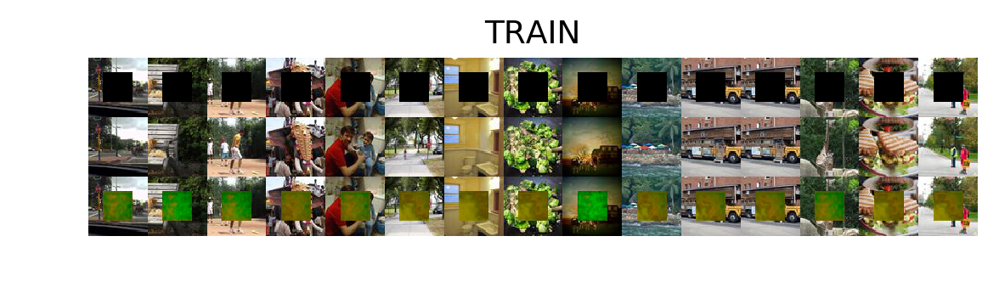

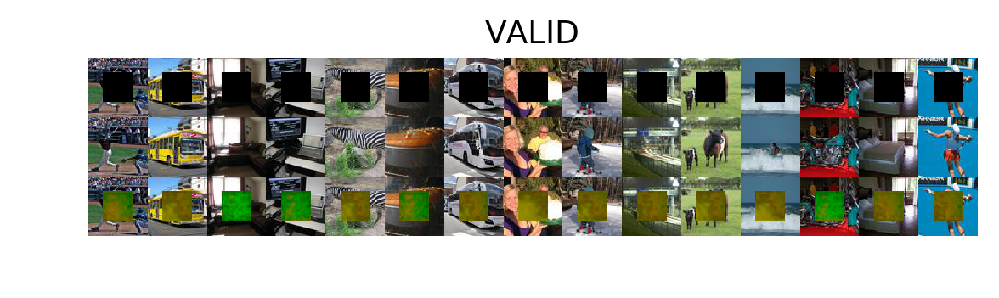

EPOCH 0: Avg cost train 0.088660, cost val 0.052202, took 599.340038 s
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160


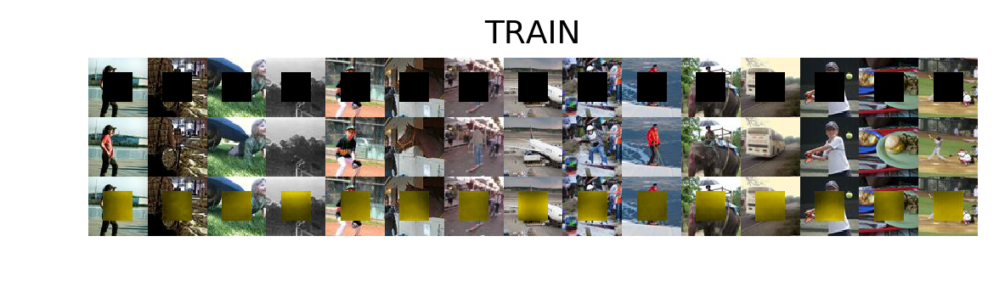

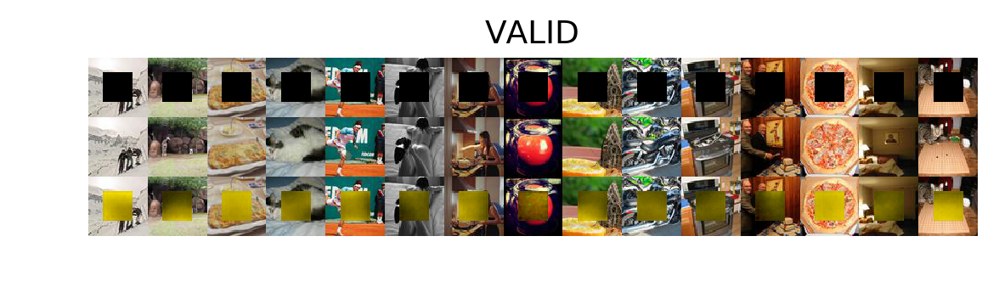

EPOCH 1: Avg cost train 0.085039, cost val 0.041405, took 429.372433 s
saving last model
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160


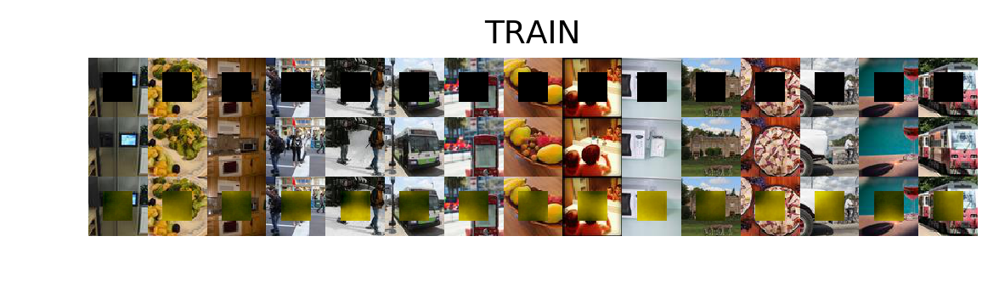

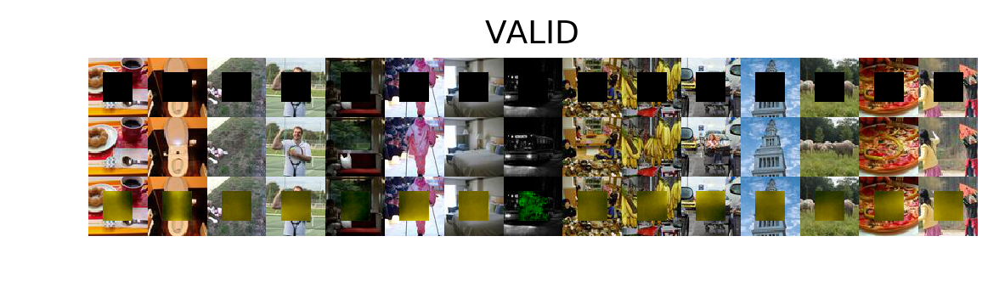

EPOCH 2: Avg cost train 0.082976, cost val 0.042507, took 404.029971 s
saving best (and last) model
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160


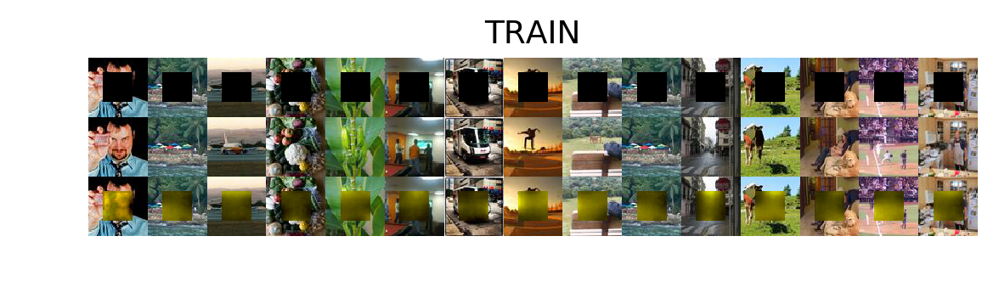

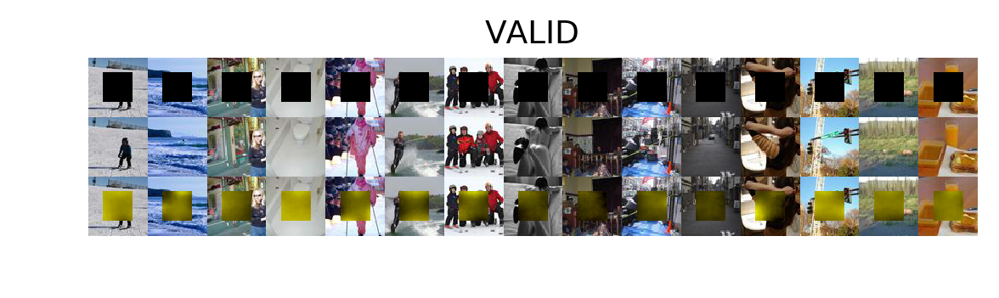

EPOCH 3: Avg cost train 0.082094, cost val 0.041692, took 413.257680 s
saving best (and last) model
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160


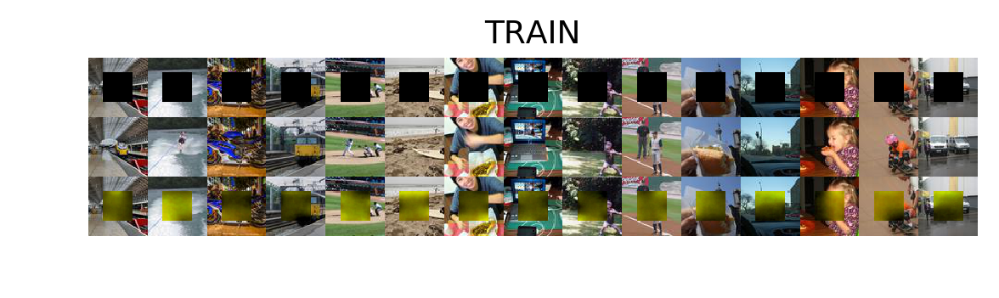

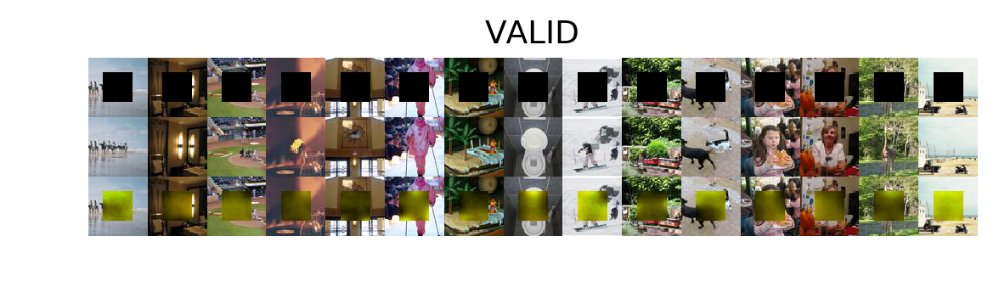

EPOCH 4: Avg cost train 0.081544, cost val 0.042000, took 356.975487 s
saving last model
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160


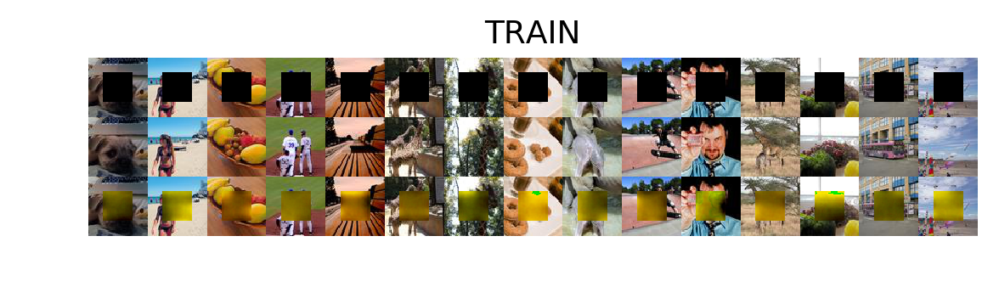

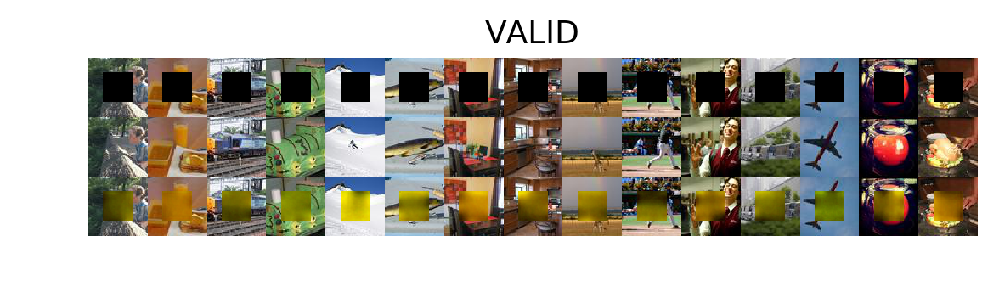

EPOCH 5: Avg cost train 0.080839, cost val 0.039829, took 360.159684 s
saving best (and last) model
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160


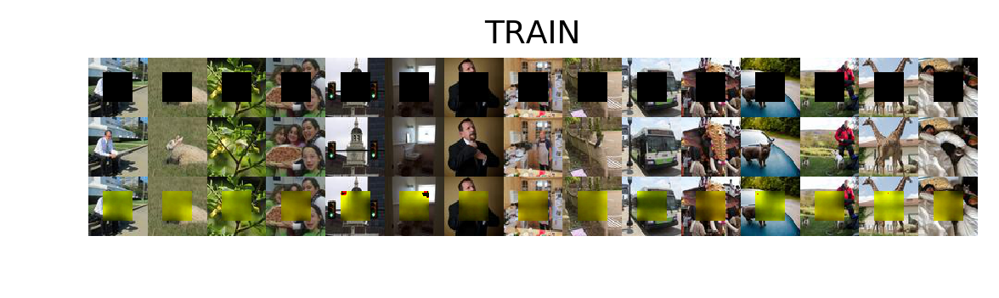

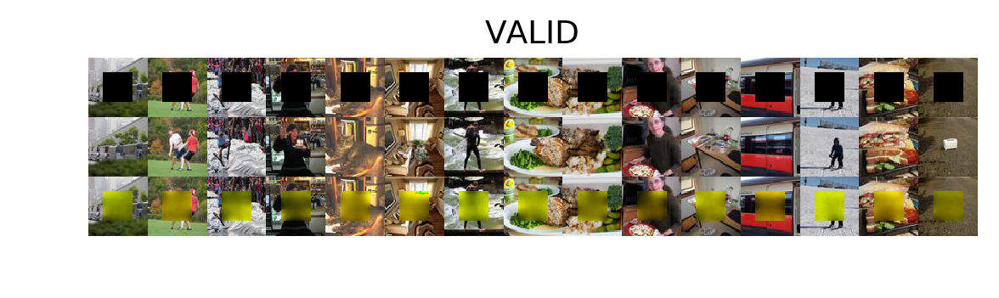

EPOCH 6: Avg cost train 0.080325, cost val 0.041112, took 339.834649 s
saving last model
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160


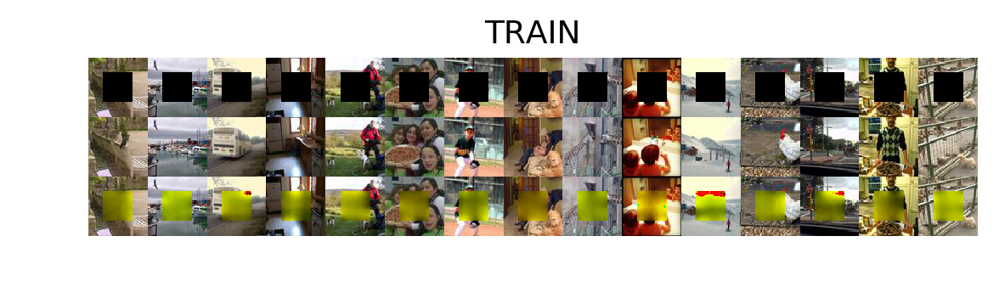

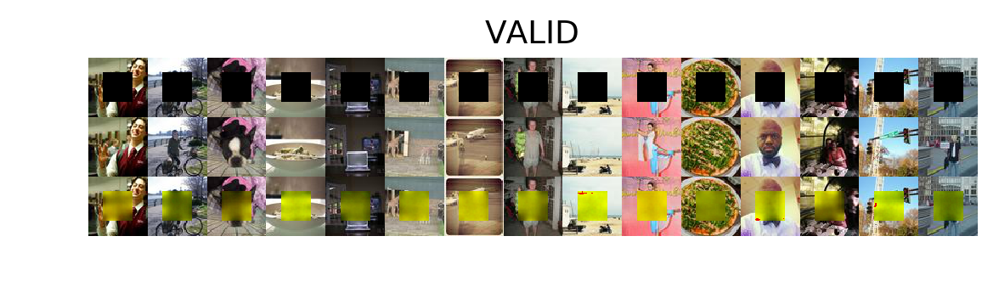

EPOCH 7: Avg cost train 0.080109, cost val 0.041819, took 343.146709 s
saving last model
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160


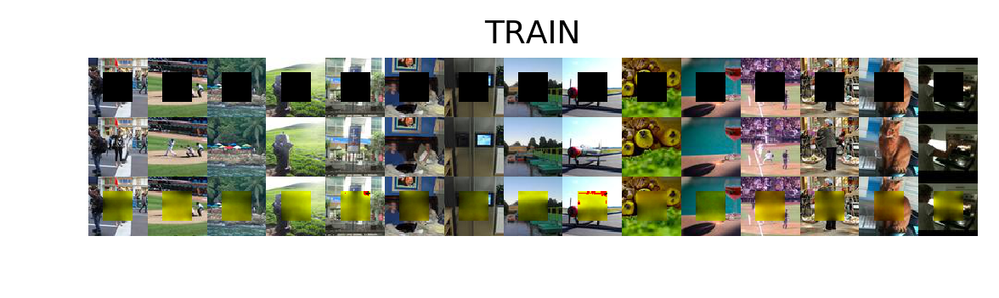

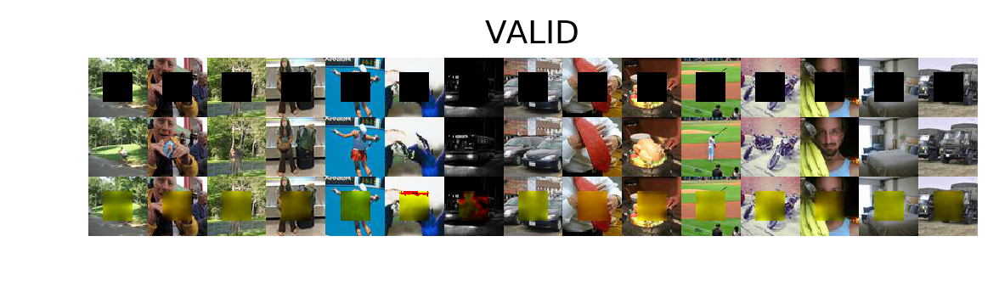

EPOCH 8: Avg cost train 0.079882, cost val 0.039371, took 340.144849 s
saving best (and last) model
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160


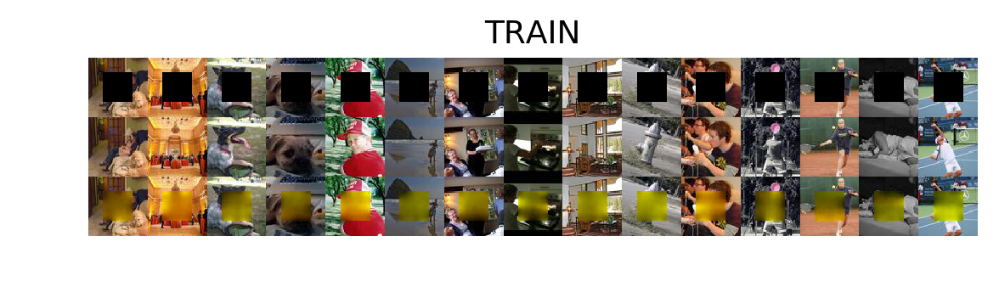

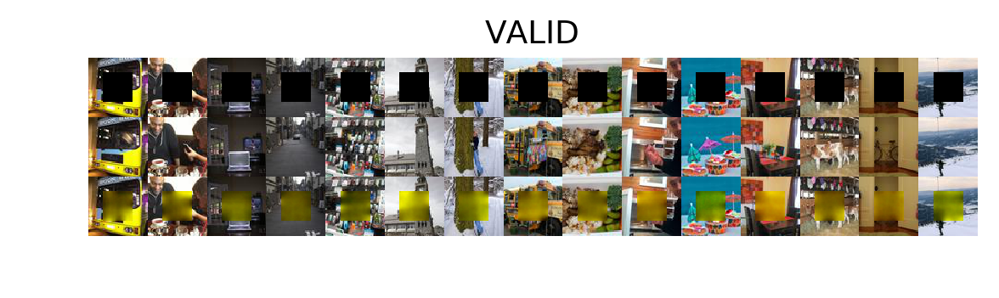

EPOCH 9: Avg cost train 0.079687, cost val 0.039677, took 351.730571 s
saving last model
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160


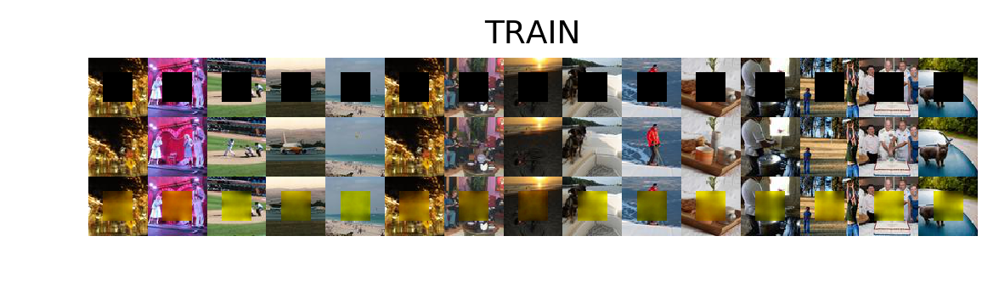

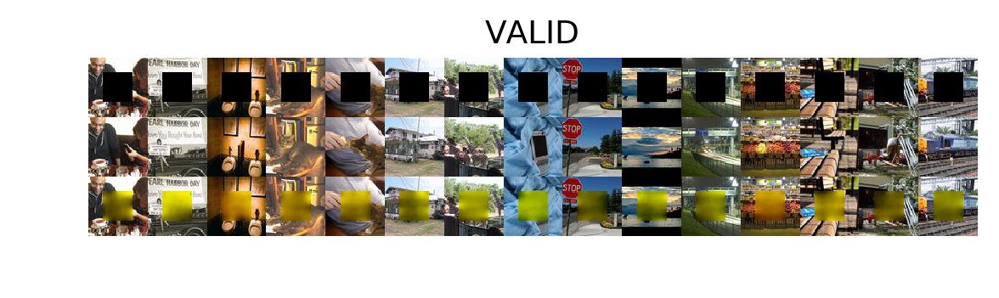

EPOCH 10: Avg cost train 0.079451, cost val 0.039779, took 345.422160 s
saving last model
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160


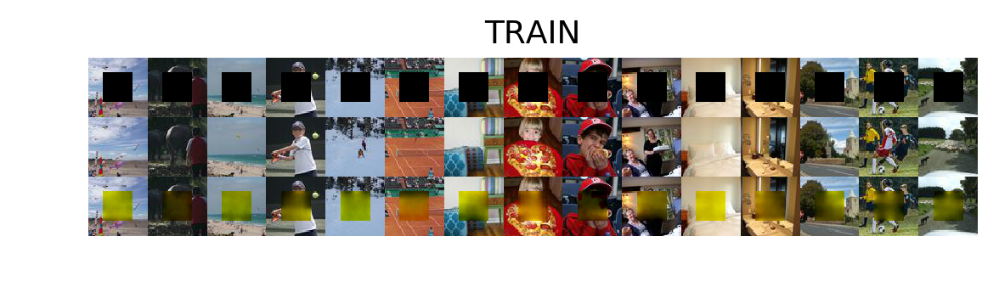

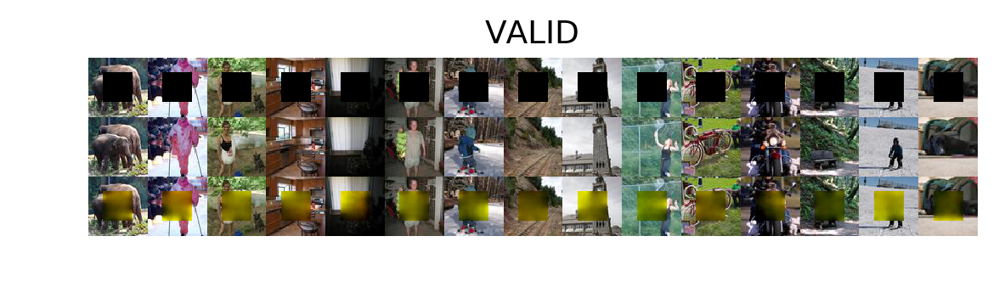

EPOCH 11: Avg cost train 0.079281, cost val 0.039602, took 375.372776 s
saving last model
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160


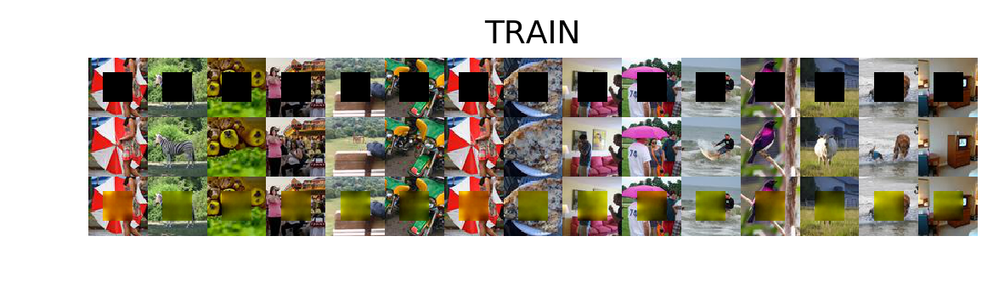

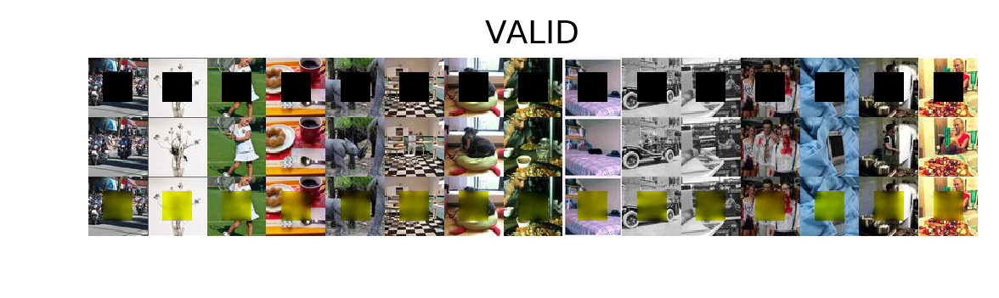

EPOCH 12: Avg cost train 0.079128, cost val 0.039836, took 356.004176 s
saving last model
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160


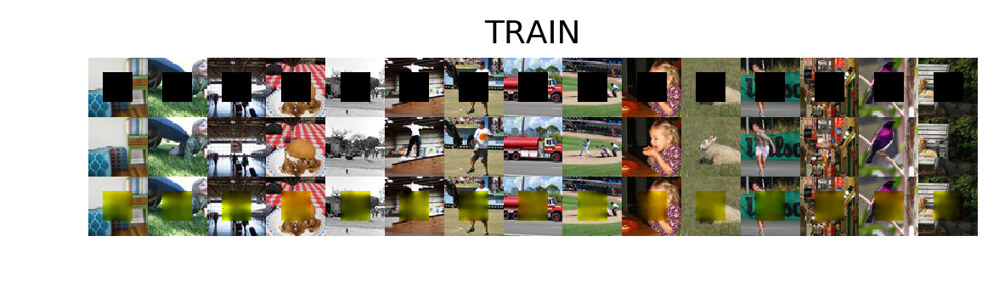

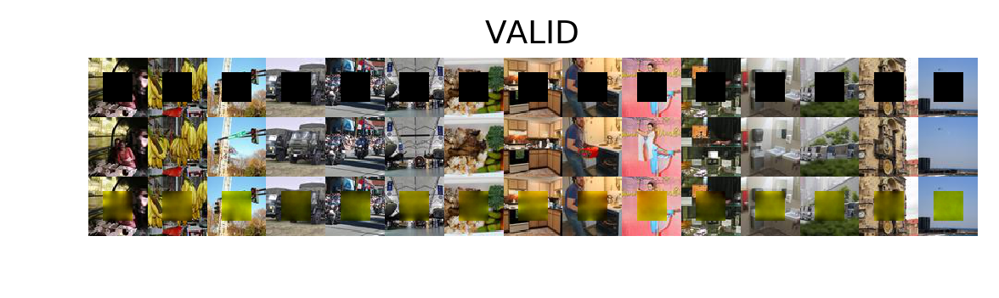

EPOCH 13: Avg cost train 0.078970, cost val 0.039847, took 350.843404 s
saving last model
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160


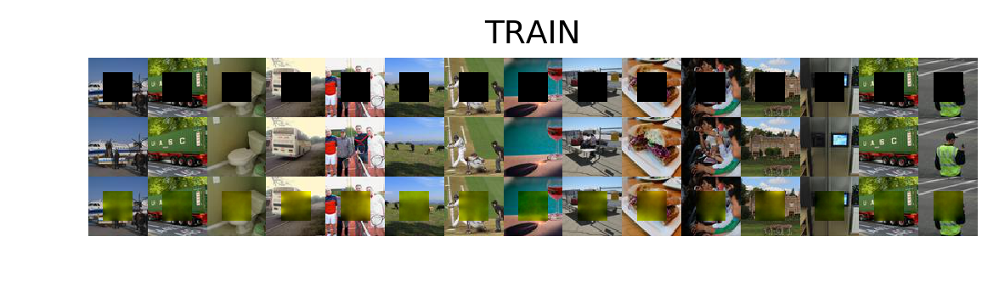

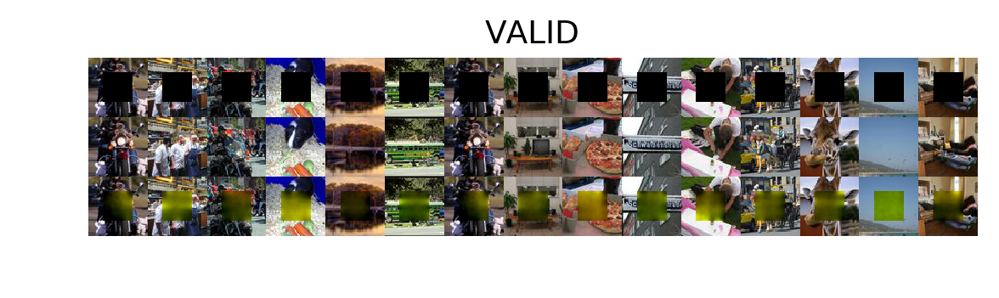

EPOCH 14: Avg cost train 0.078792, cost val 0.041309, took 350.066589 s
saving last model
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160


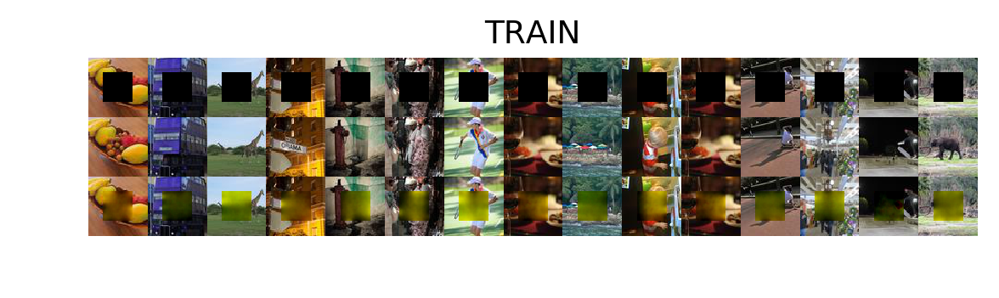

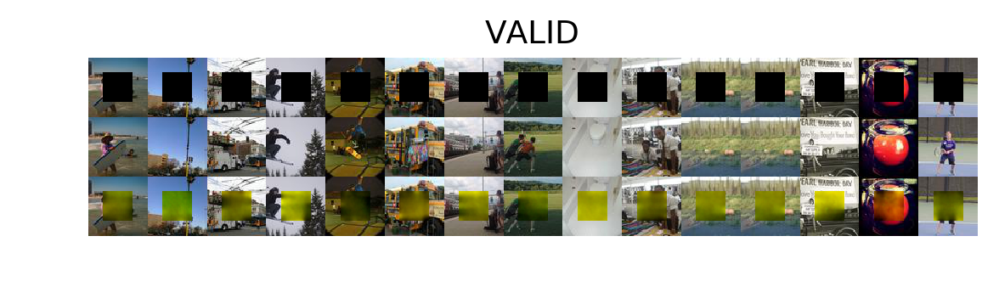

EPOCH 15: Avg cost train 0.078650, cost val 0.040633, took 390.836510 s
saving last model
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160


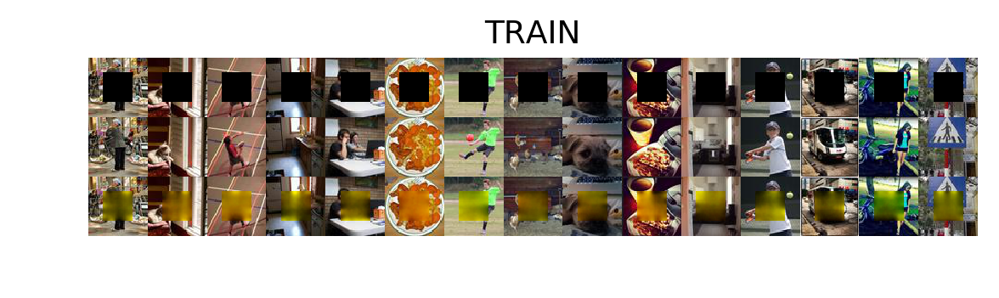

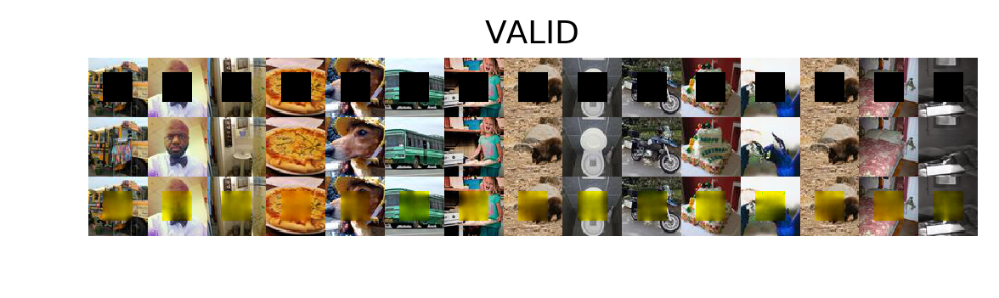

EPOCH 16: Avg cost train 0.078432, cost val 0.038830, took 355.705862 s
saving best (and last) model
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160


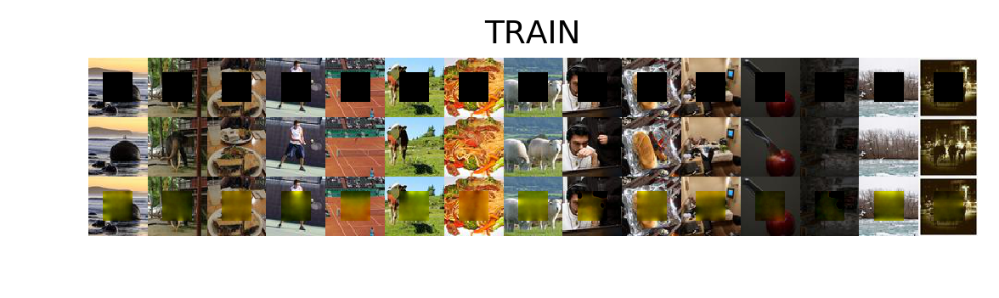

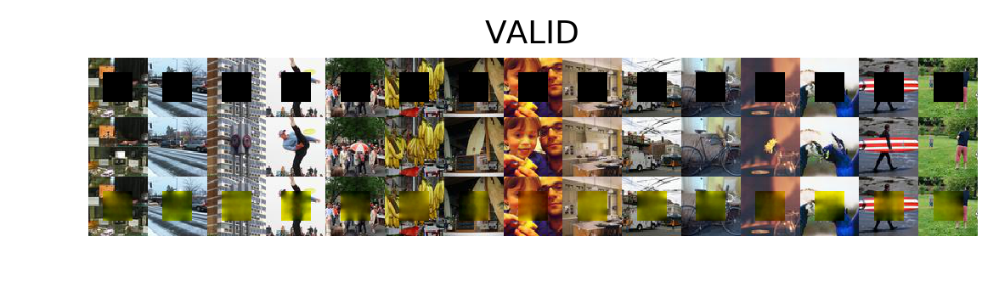

EPOCH 17: Avg cost train 0.078233, cost val 0.040183, took 352.922708 s
saving last model
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160


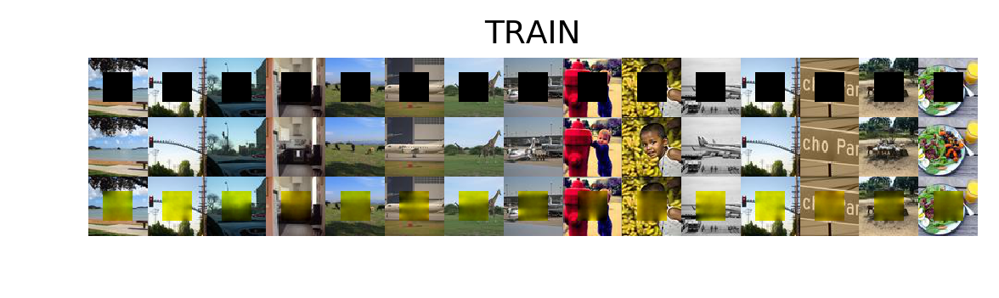

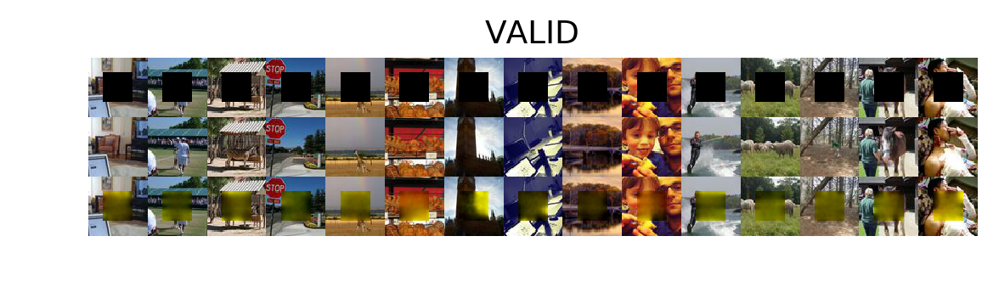

EPOCH 18: Avg cost train 0.077970, cost val 0.039597, took 351.011086 s
saving last model
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160


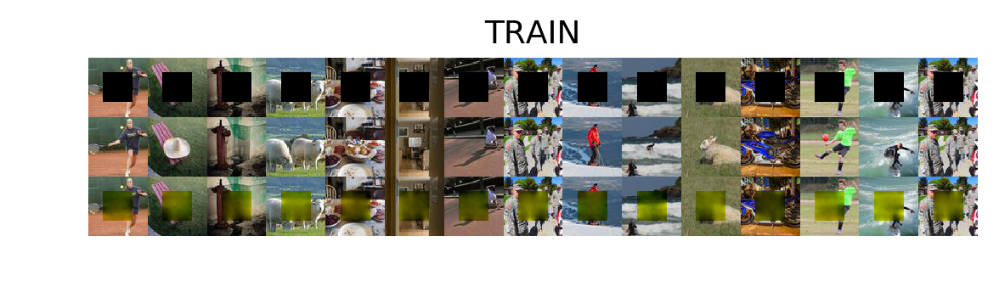

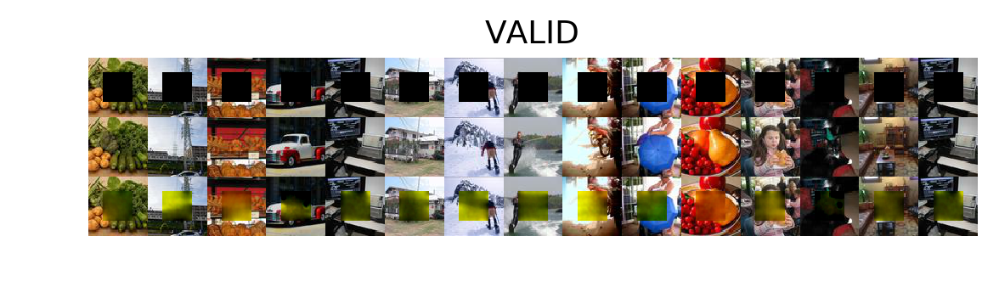

EPOCH 19: Avg cost train 0.077717, cost val 0.041643, took 347.357254 s
saving last model
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160


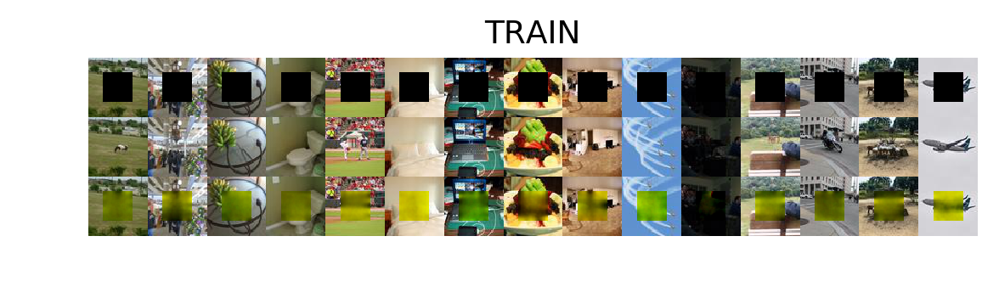

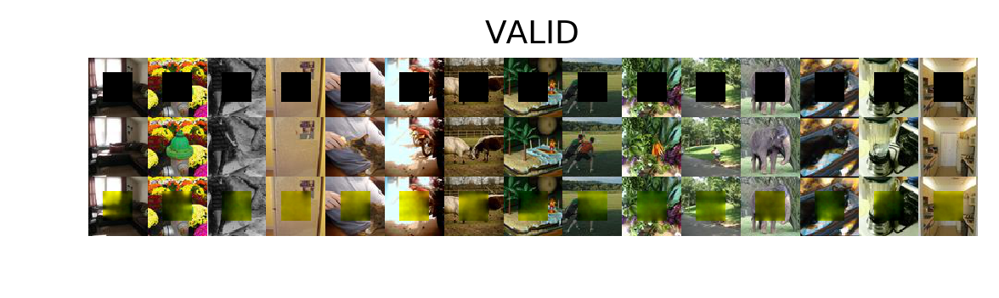

EPOCH 20: Avg cost train 0.077469, cost val 0.040173, took 350.985746 s
saving last model
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160


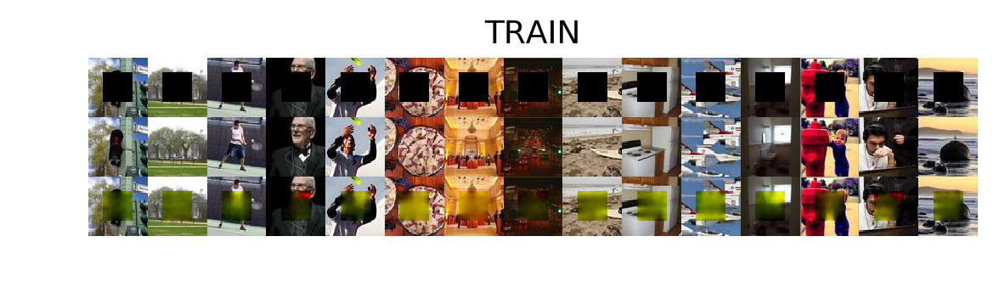

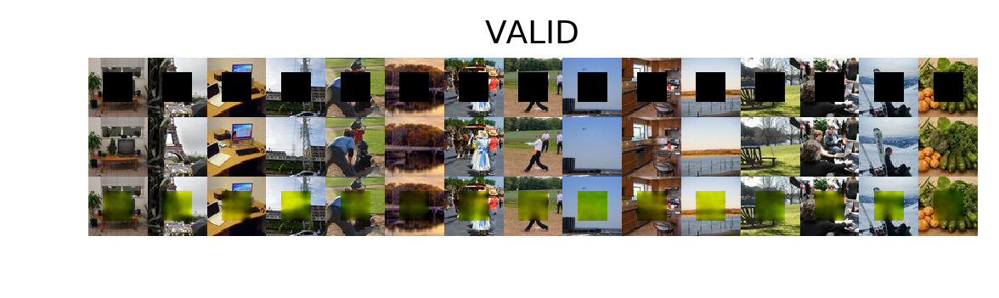

EPOCH 21: Avg cost train 0.077243, cost val 0.041490, took 343.469745 s
saving last model
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160


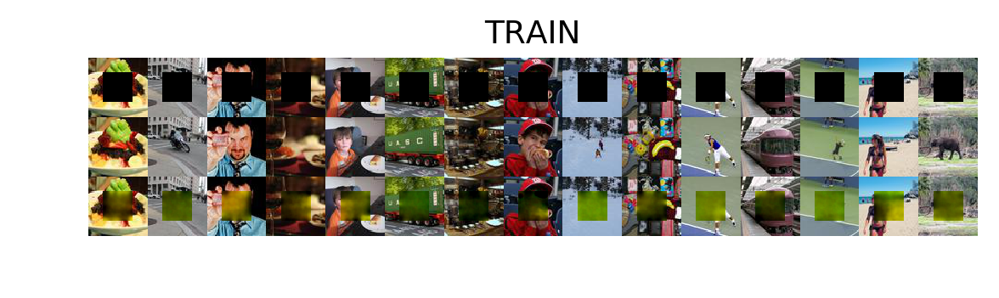

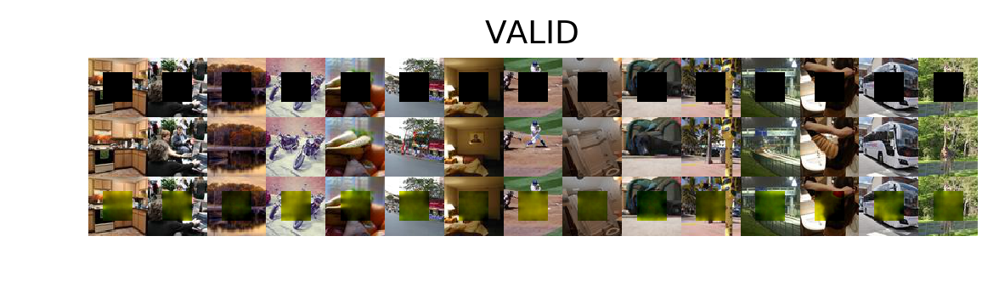

EPOCH 22: Avg cost train 0.077029, cost val 0.045020, took 343.673400 s
saving last model
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160


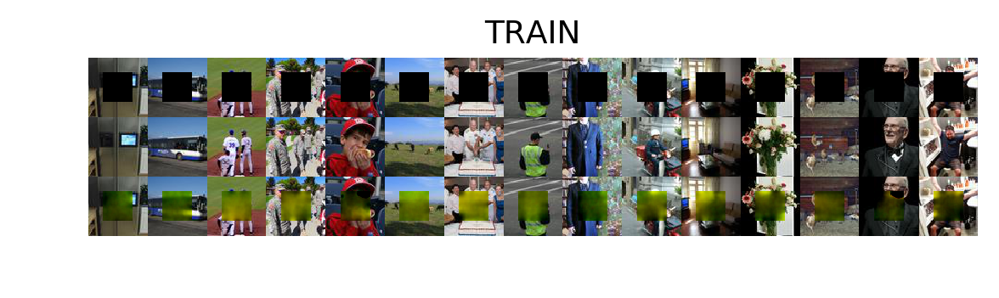

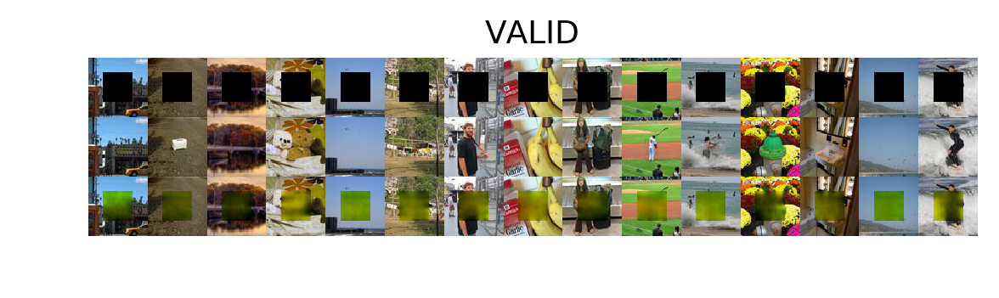

EPOCH 23: Avg cost train 0.076888, cost val 0.041341, took 342.185196 s
saving last model
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160


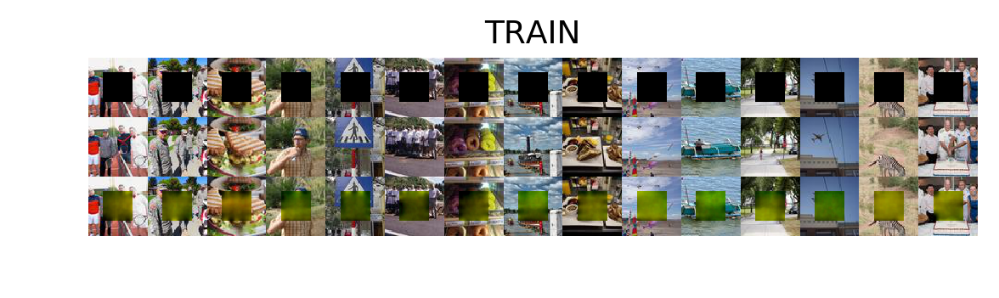

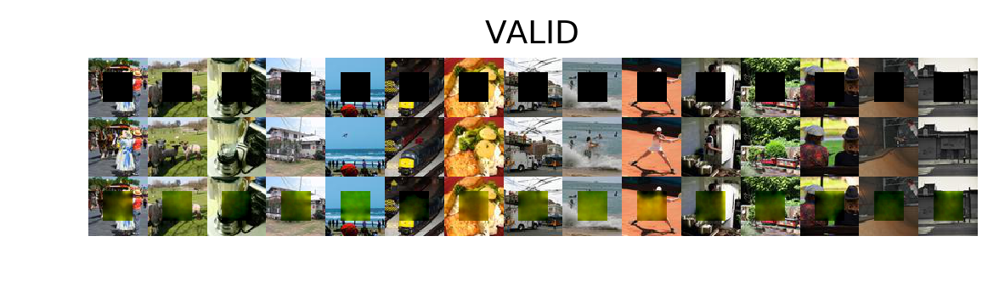

EPOCH 24: Avg cost train 0.076770, cost val 0.046392, took 347.669814 s
saving last model
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160


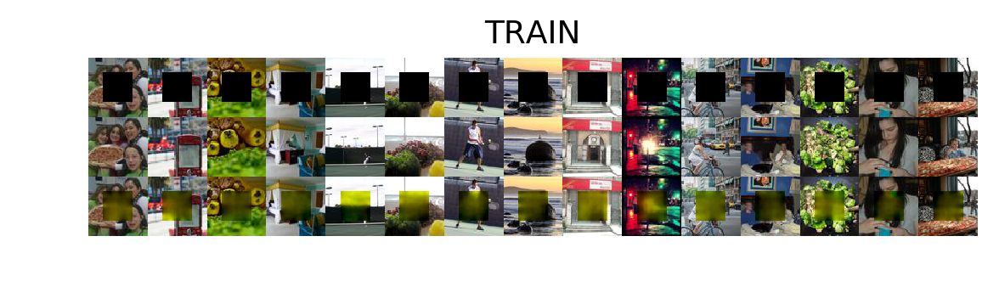

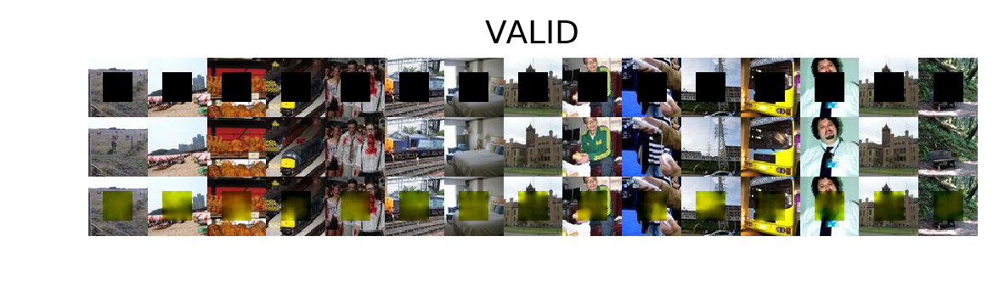

EPOCH 25: Avg cost train 0.076678, cost val 0.043626, took 386.457436 s
saving last model
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160


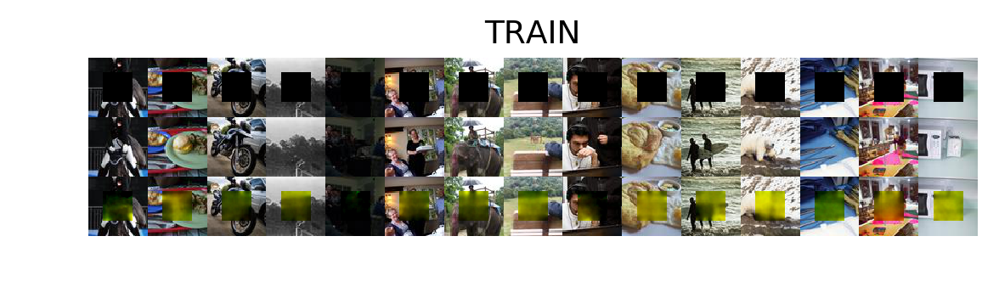

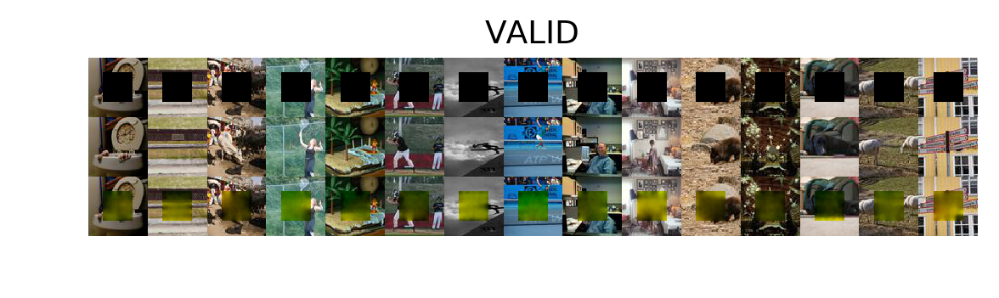

EPOCH 26: Avg cost train 0.076507, cost val 0.041968, took 338.635115 s
saving last model
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160


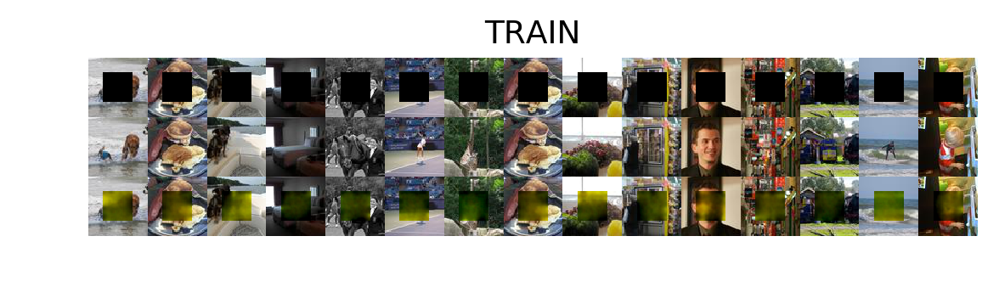

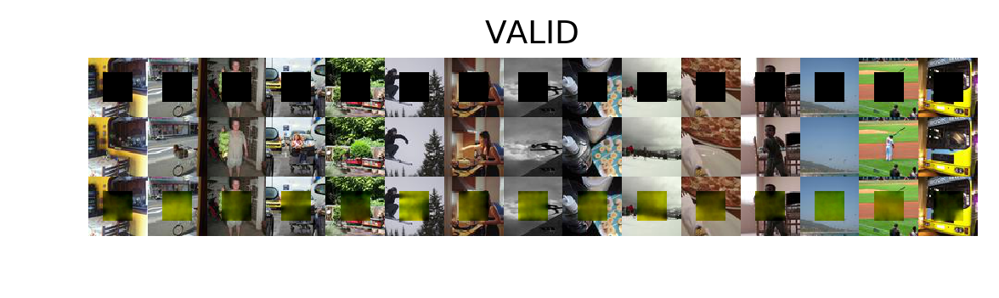

EPOCH 27: Avg cost train 0.076404, cost val 0.047722, took 343.377537 s
saving last model
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160


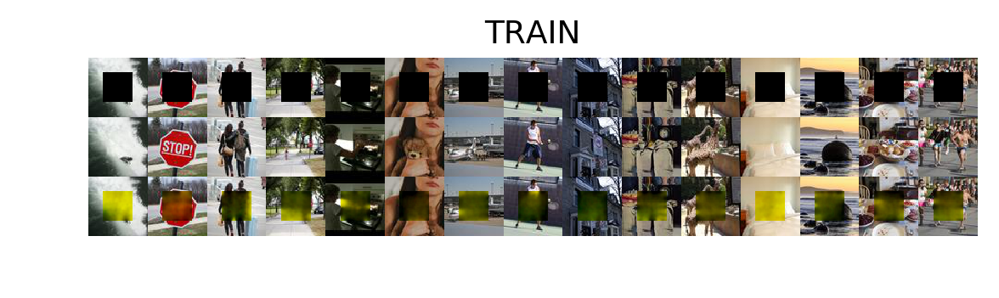

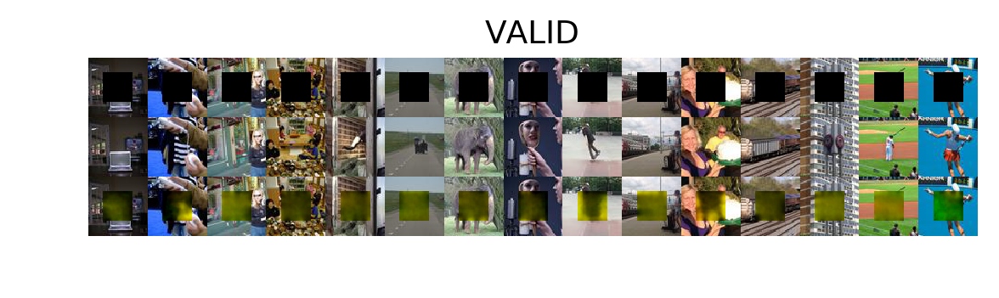

EPOCH 28: Avg cost train 0.076266, cost val 0.045472, took 369.113424 s
saving last model
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160


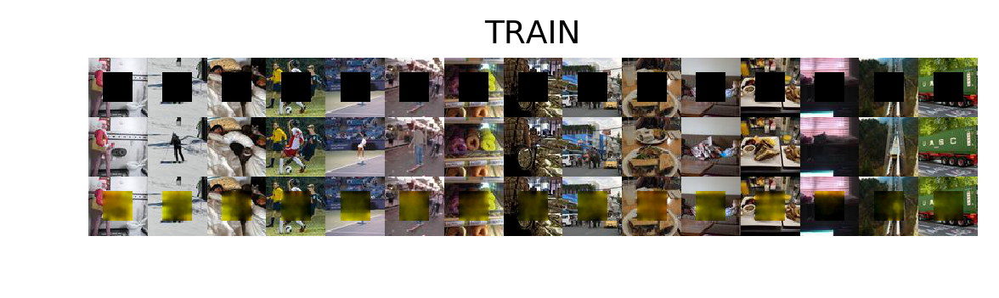

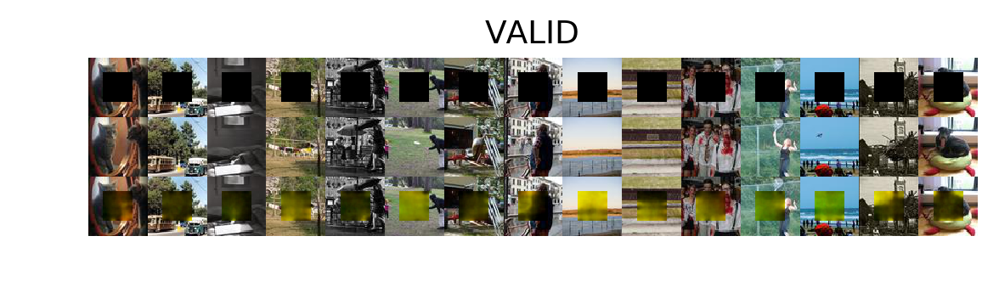

EPOCH 29: Avg cost train 0.076150, cost val 0.042969, took 388.527670 s
saving last model
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160


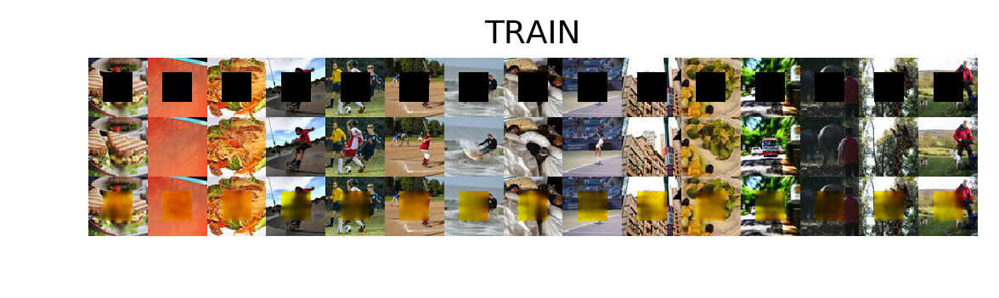

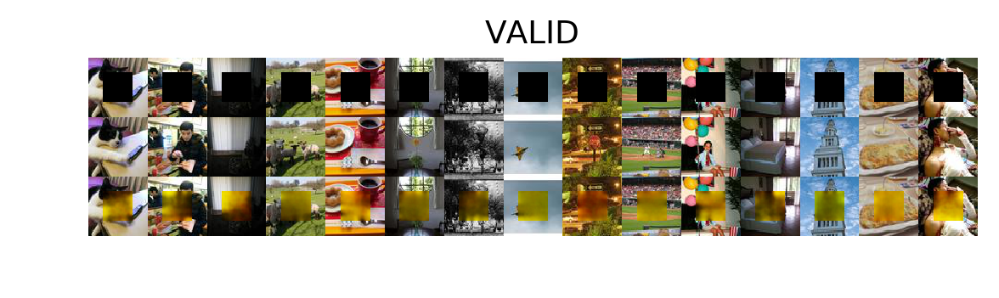

EPOCH 30: Avg cost train 0.076073, cost val 0.040379, took 354.187786 s
saving last model
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160


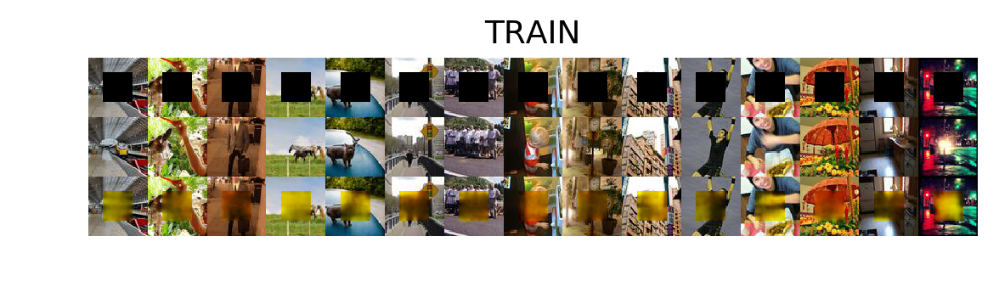

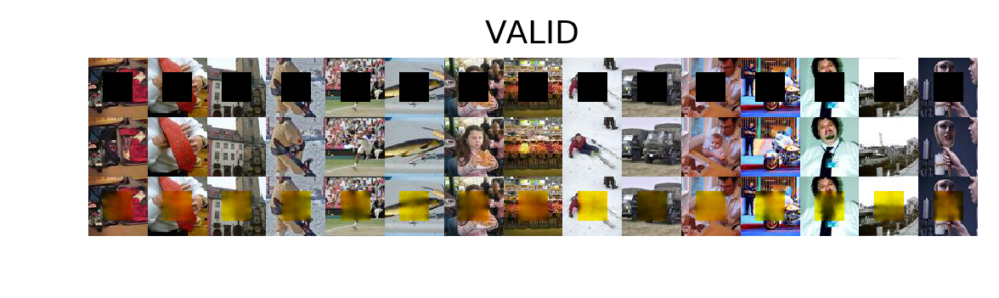

EPOCH 31: Avg cost train 0.075946, cost val 0.040119, took 365.794591 s
saving last model
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160


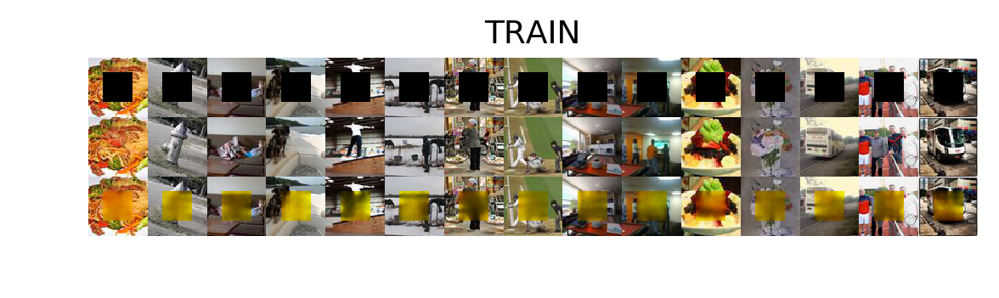

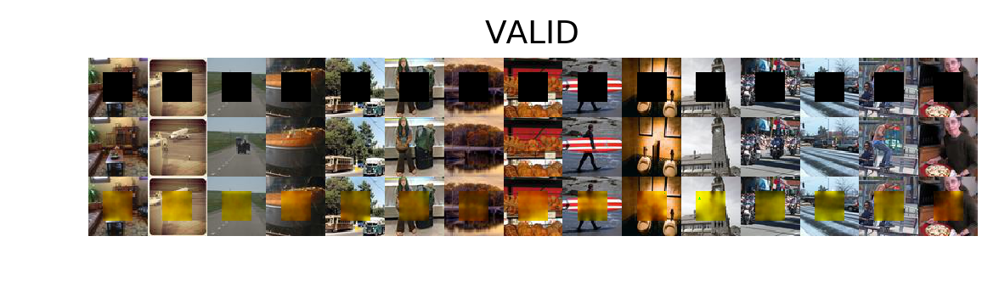

EPOCH 32: Avg cost train 0.075878, cost val 0.040568, took 345.323352 s
saving last model
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160


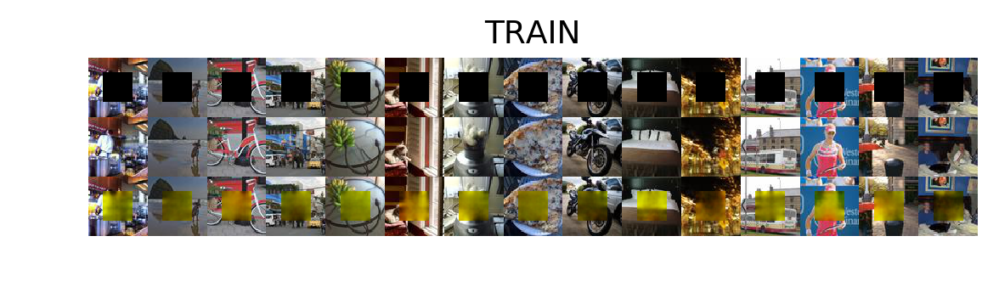

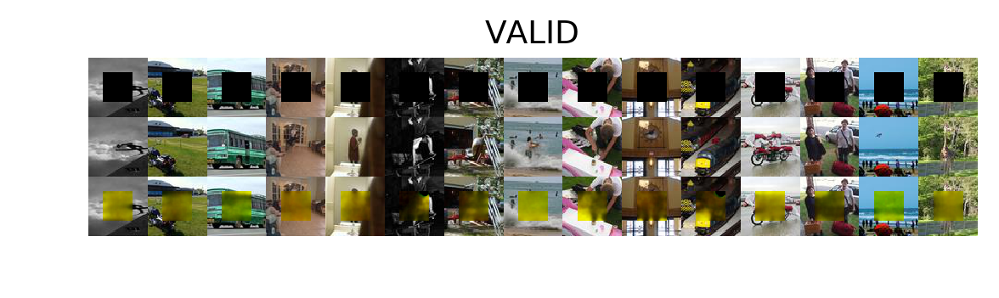

EPOCH 33: Avg cost train 0.075925, cost val 0.039525, took 349.673167 s
saving last model
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160


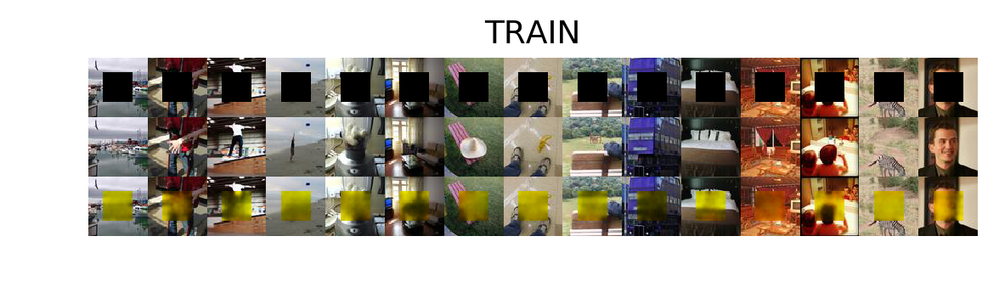

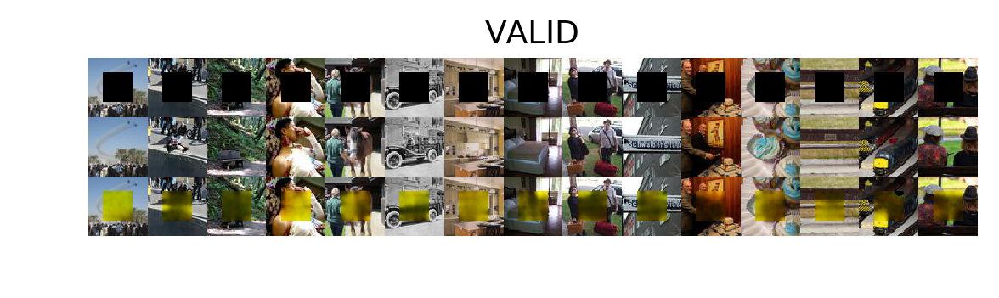

EPOCH 34: Avg cost train 0.075896, cost val 0.039650, took 353.329665 s
saving last model
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160


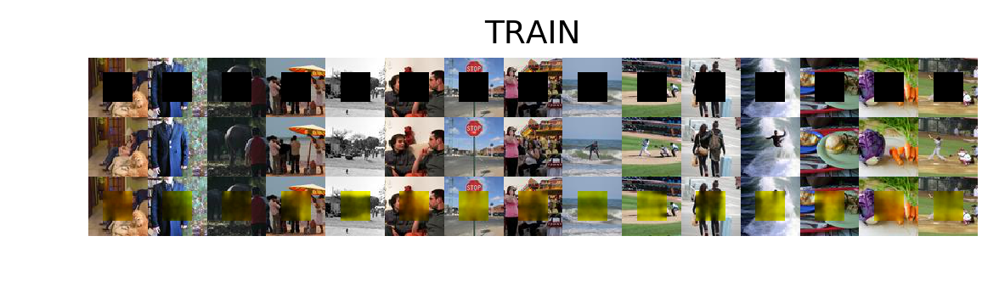

IndexError: tuple index out of range

In [31]:
#
# Train loop
#



# Training main loop
print "Start training"

for epoch in range(num_epochs):
    #learn_step.set_value((learn_step.get_value()*0.99).astype(theano.config.floatX))
    
    start_time = time.time()
    cost_train_epoch = 0
    
    # Train      
        
    for i, train_batch in enumerate(train_iter):
        print i
        if n_batches_train > 0 and i> n_batches_train:
            break
        
        train_batch = extract_batch(train_batch)
        inputs_train, targets_train, caps_train = train_batch
        
        cost_train_batch = cost_minibatch = ae_train_fn(inputs_train, caps_train, targets_train)
        
        #print i, 'training batch cost : ', cost_train_batch

        #Update epoch results    
        cost_train_epoch += cost_train_batch
        
        
        
    #Add epoch results    
    err_train += [cost_train_epoch/n_batches_train]
    if plot_results_train: #select random example from the last minibatch and plot it
        test_and_plot(train_batch, title = 'TRAIN')
    

    # Validation
    cost_val_epoch = 0
    

    for i, valid_batch in enumerate(valid_iter):
        
        if n_batches_valid > 0 and i> n_batches_valid:
            break

        valid_batch = extract_batch(valid_batch)
        inputs_valid, targets_valid, caps_valid = valid_batch

        # Validation step
        cost_val_batch = ae_valid_fn(inputs_valid, caps_valid, targets_valid)
        #print i, 'validation batch cost : ', cost_val_batch


        #Update epoch results
        cost_val_epoch += cost_val_batch
        
    
    if plot_results_valid: #select random example from the last minibatch and plot it
        test_and_plot(valid_batch, title = 'VALID')
        
    #Add epoch results 
    err_valid += [cost_val_epoch/n_batches_valid]
    

    #Print results (once per epoch)
    out_str = "EPOCH %i: Avg cost train %f, cost val %f, took %f s"
    out_str = out_str % (epoch, err_train[epoch],
                         #acc_train[epoch],
                         err_valid[epoch],
                         #acc_valid[epoch],
                         time.time()-start_time)
    print out_str
   
    

    # Early stopping and saving stuff
    
    with open(os.path.join(savepath, "ae_output.log"), "a") as f:
        f.write(out_str + "\n")
        
    if epoch == 0 and reset_best_results:
        best_err_valid = err_valid[epoch]
    elif epoch > 1 and err_valid[epoch] < best_err_valid:
        print('saving best (and last) model')
        best_err_valid = err_valid[epoch]
        patience = 0
        np.savez(os.path.join(savepath, 'ae_model_best.npz'),
                 *lasagne.layers.get_all_param_values(ae[last_layer]))
        np.savez(os.path.join(savepath , "ae_errors_best.npz"),
                 err_train=err_train, err_valid=err_valid)
        np.savez(os.path.join(savepath, 'ae_model_last.npz'),
                 *lasagne.layers.get_all_param_values(ae[last_layer]))
        np.savez(os.path.join(savepath , "ae_errors_last.npz"),
                 err_train=err_train, err_valid=err_valid)
    else:
        patience += 1
        print('saving last model')
        np.savez(os.path.join(savepath, 'ae_model_last.npz'),
                 *lasagne.layers.get_all_param_values(ae[last_layer]))
        np.savez(os.path.join(savepath , "ae_errors_last.npz"),
                 err_train=err_train, err_valid=err_valid)
        
    # Finish training if patience has expired or max nber of epochs reached
    if patience == max_patience or epoch == num_epochs-1:
        if savepath != loadpath:
            print('Copying model and other training files to {}'.format(loadpath))
            copy_tree(savepath, loadpath)
        break 




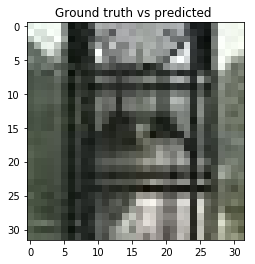

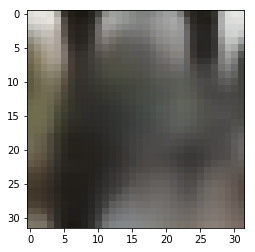

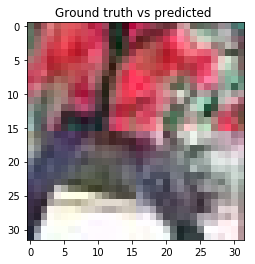

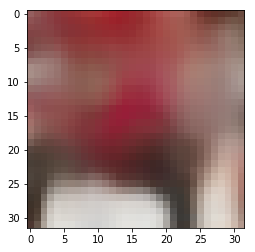

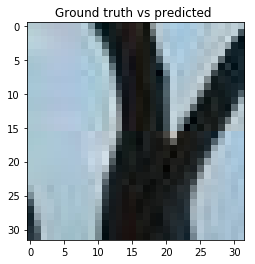

...

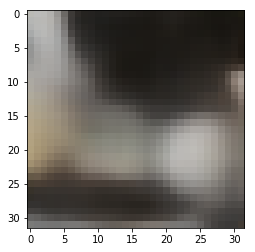

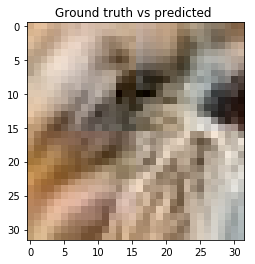

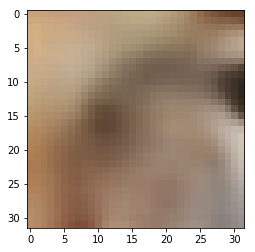

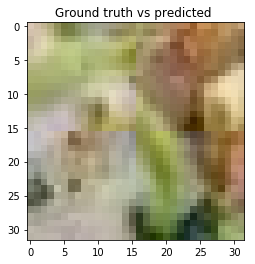

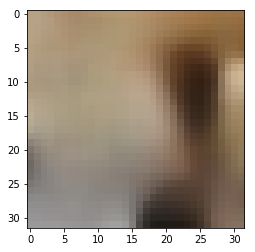

In [127]:
batch_train = extract_stuff(train_iter[400:1000])
        
show_true_fake(batch_train, subset=20)

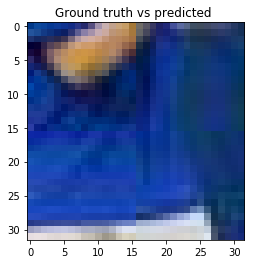

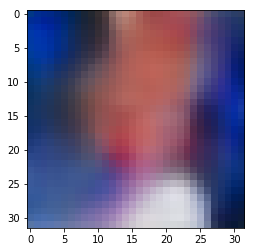

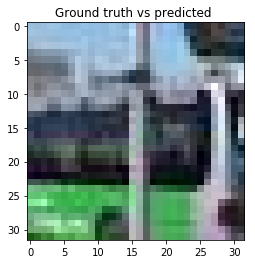

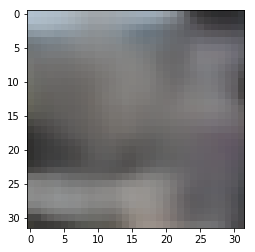

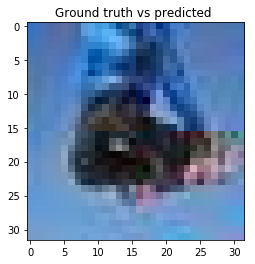

...

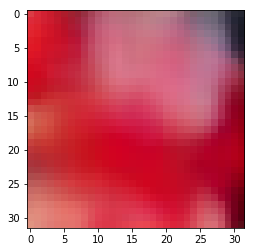

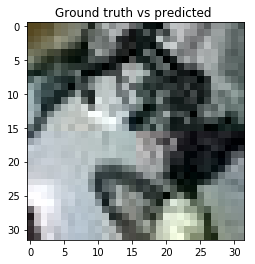

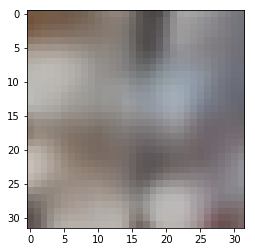

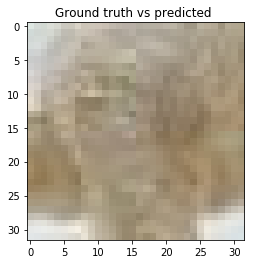

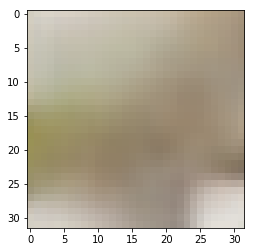

In [130]:
batch_valid = extract_stuff(valid_iter[1500:2000])

show_true_fake(batch_valid, subset = 20)